<a href="https://colab.research.google.com/github/Rohit-csv/PPC/blob/master/Interpolation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

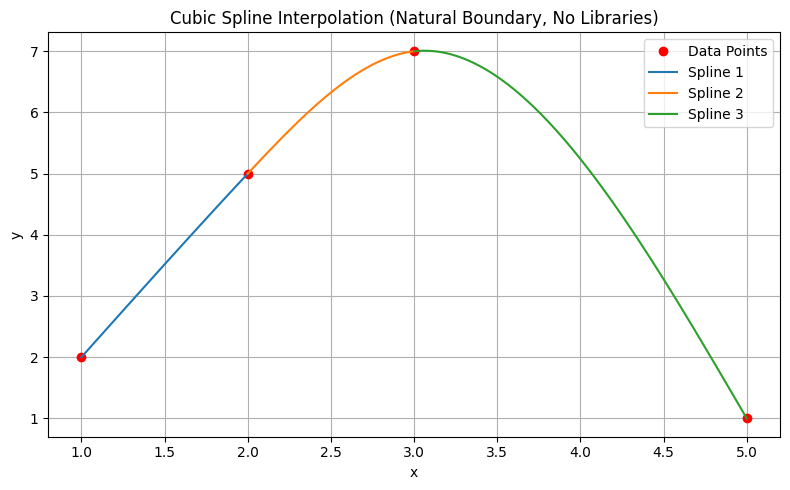

In [ ]:
# Checkpoint 1.1
import matplotlib.pyplot as plt

# Given data points
x = [1, 2, 3, 5]
y = [2, 5, 7, 1]
n = len(x) # x ki length store kar raha ha n me bas

# Step size between x values
h = [x[i+1] - x[i] for i in range(n-1)]  # [1, 1, 2]
# idhar h me ek vector store ho raha ha jiske andar distance ha between two elements .

# Initialize matrix A and vector B for natural spline
A = [[0]*n for _ in range(n)]  #This creates an n×n matrix filled with zero
B = [0]*n  #This creates a vector of size n, filled with zeros.

# Natural boundary conditions
A[0][0] = 1
A[n-1][n-1] = 1
B[0] = 0
B[n-1] = 0

# Fill A and B based on second derivative continuity
for i in range(1, n-1):
    A[i][i-1] = h[i-1]
    A[i][i] = 2 * (h[i-1] + h[i])
    A[i][i+1] = h[i]
    B[i] = 3 * ((y[i+1] - y[i]) / h[i] - (y[i] - y[i-1]) / h[i-1])

# -------------------------------
# Manual forward elimination + back substitution
# -------------------------------

# Forward elimination
for i in range(1, n):
    m = A[i][i-1] / A[i-1][i-1]
    for j in range(i-1, n):
        A[i][j] -= m * A[i-1][j]
    B[i] -= m * B[i-1]

# Back substitution
c = [0]*n
c[-1] = B[-1] / A[-1][-1]
for i in range(n-2, -1, -1):
    s = sum(A[i][j] * c[j] for j in range(i+1, n))
    c[i] = (B[i] - s) / A[i][i]

# Solve for a, b, d
a = y[:-1]
b = [0]*(n-1)
d = [0]*(n-1)

for i in range(n-1):
    b[i] = (y[i+1] - y[i])/h[i] - h[i]*(2*c[i] + c[i+1])/3
    d[i] = (c[i+1] - c[i]) / (3*h[i])

# -----------------------------------------
# Plotting the interpolated spline segments
# -----------------------------------------
plt.figure(figsize=(8, 5))
plt.plot(x, y, 'ro', label="Data Points")

for i in range(n-1):
    xi = x[i]
    xf = x[i+1]
    xs = [xi + t*(xf - xi)/100.0 for t in range(101)]
    ys = [a[i] + b[i]*(xj - xi) + c[i]*(xj - xi)**2 + d[i]*(xj - xi)**3 for xj in xs]
    plt.plot(xs, ys, label=f"Spline {i+1}")

plt.title("Cubic Spline Interpolation (Natural Boundary, No Libraries)")
plt.xlabel("x")
plt.ylabel("y")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()



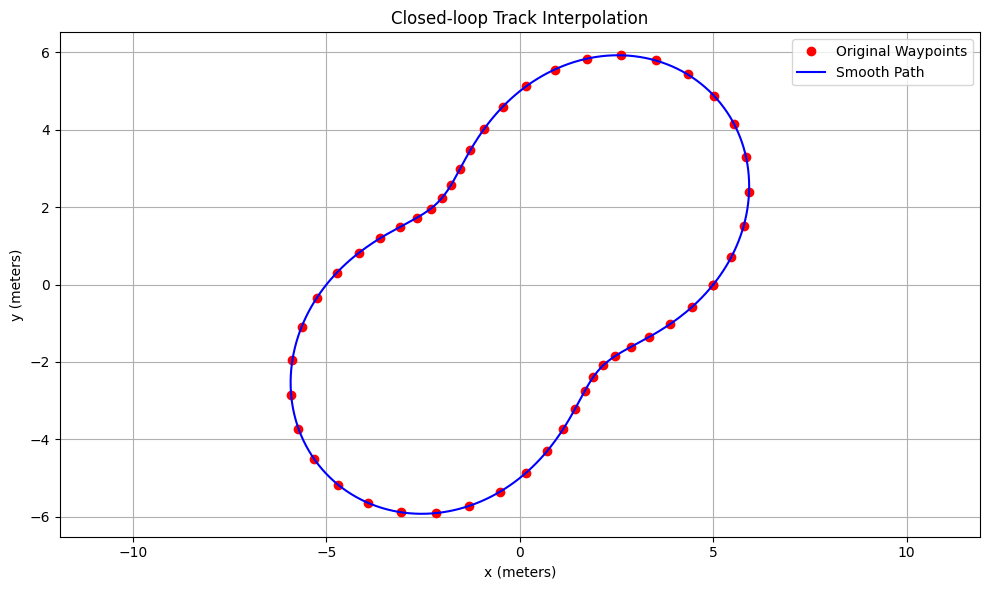

In [ ]:
# Checkpoint 1.2
# Import required libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import splprep, splev

# Step 1: Load CSV using pandas
df = pd.read_csv('loop_track_waypoints.csv')  # Ensure this file is in your working directory

# Step 2: Extract x and y coordinates
x = df['X'].values
y = df['Y'].values

# Step 3: Ensure the loop is closed (last point = first point)
if x[0] != x[-1] or y[0] != y[-1]:
    x = np.append(x, x[0])
    y = np.append(y, y[0])

# Step 4: Use parametric spline interpolation with periodic boundary conditions
# splprep returns a tuple (tck, u) where:
# - tck is the spline representation
# - u is the parameter (normalized distance along the curve)
tck, u = splprep([x, y], s=0, per=True)

# Step 5: Evaluate the spline at many points for a smooth curve
u_fine = np.linspace(0, 1, 500)  # Generate 500 points for a smooth line
x_smooth, y_smooth = splev(u_fine, tck)

# Step 6: Plot original waypoints and smooth spline
plt.figure(figsize=(10, 6))
plt.plot(x, y, 'ro', label='Original Waypoints')           # Red dots for original points
plt.plot(x_smooth, y_smooth, 'b-', label='Smooth Path')    # Blue line for spline
plt.title("Closed-loop Track Interpolation")
plt.xlabel("x (meters)")
plt.ylabel("y (meters)")
plt.axis('equal')  # Keep aspect ratio square
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


Total squared curvature (original): 187.4216
Total squared curvature (optimized): 0.0137


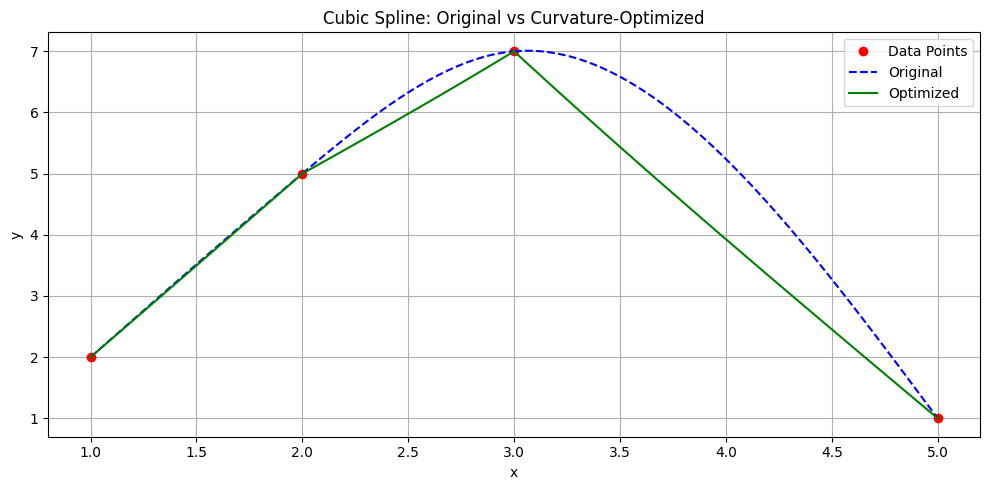

In [ ]:
# CHeckpint 2
import matplotlib.pyplot as plt
import numpy as np
import copy

# Given data points
x = [1, 2, 3, 5]
y = [2, 5, 7, 1]
n = len(x)

# Step size
h = [x[i+1] - x[i] for i in range(n-1)]

# ------------------------
# Natural Spline Function
# ------------------------
def compute_natural_spline(x, y, h):
    n = len(x)
    A = [[0]*n for _ in range(n)]
    B = [0]*n

    A[0][0] = 1
    A[n-1][n-1] = 1
    B[0] = 0
    B[n-1] = 0

    for i in range(1, n-1):
        A[i][i-1] = h[i-1]
        A[i][i] = 2 * (h[i-1] + h[i])
        A[i][i+1] = h[i]
        B[i] = 3 * ((y[i+1] - y[i]) / h[i] - (y[i] - y[i-1]) / h[i-1])

    # Forward elimination
    for i in range(1, n):
        m = A[i][i-1] / A[i-1][i-1]
        for j in range(i-1, n):
            A[i][j] -= m * A[i-1][j]
        B[i] -= m * B[i-1]

    # Back substitution
    c = [0]*n
    c[-1] = B[-1] / A[-1][-1]
    for i in range(n-2, -1, -1):
        s = sum(A[i][j] * c[j] for j in range(i+1, n))
        c[i] = (B[i] - s) / A[i][i]

    a = y[:-1]
    b = [0]*(n-1)
    d = [0]*(n-1)
    for i in range(n-1):
        b[i] = (y[i+1] - y[i])/h[i] - h[i]*(2*c[i] + c[i+1])/3
        d[i] = (c[i+1] - c[i]) / (3*h[i])

    return a, b, c, d

# ----------------------------
# Curvature computation
# ----------------------------
def compute_total_curvature(a, b, c, d, x, n, samples_per_seg=50):
    total_curvature = 0.0
    for i in range(n-1):
        xi = x[i]
        hi = x[i+1] - xi
        xs = np.linspace(0, hi, samples_per_seg)
        for t in xs:
            f1 = b[i] + 2*c[i]*t + 3*d[i]*t**2      # f'(x)
            f2 = 2*c[i] + 6*d[i]*t                  # f''(x)
            curvature = abs(f2) / (1 + f1**2)**1.5
            total_curvature += curvature**2
    return total_curvature

# ---------------------------
# Optimization (naive tuning)
# ---------------------------
def optimize_spline_curvature(x, y, h, iterations=100, alpha=0.01):
    # Start with natural spline
    _, _, c, _ = compute_natural_spline(x, y, h)
    c_opt = copy.deepcopy(c)

    for _ in range(iterations):
        gradients = [0]*len(c_opt)
        for j in range(1, len(c_opt)-1):  # avoid changing endpoints
            delta = 1e-4
            c_try = copy.deepcopy(c_opt)
            c_try[j] += delta
            a, b, _, d = compute_coeffs_given_c(x, y, h, c_try)
            cost1 = compute_total_curvature(a, b, c_try, d, x, len(x))

            c_try[j] -= 2 * delta
            a, b, _, d = compute_coeffs_given_c(x, y, h, c_try)
            cost2 = compute_total_curvature(a, b, c_try, d, x, len(x))

            gradients[j] = (cost1 - cost2) / (2 * delta)

        # Gradient descent step
        for j in range(1, len(c_opt)-1):
            c_opt[j] -= alpha * gradients[j]

    a, b, _, d = compute_coeffs_given_c(x, y, h, c_opt)
    return a, b, c_opt, d

# Helper to compute a,b,d given c
def compute_coeffs_given_c(x, y, h, c):
    n = len(x)
    a = y[:-1]
    b = [0]*(n-1)
    d = [0]*(n-1)
    for i in range(n-1):
        b[i] = (y[i+1] - y[i])/h[i] - h[i]*(2*c[i] + c[i+1])/3
        d[i] = (c[i+1] - c[i]) / (3*h[i])
    return a, b, c, d

# ---------------------------
# Run and Plot Comparison
# ---------------------------
a1, b1, c1, d1 = compute_natural_spline(x, y, h)
a2, b2, c2, d2 = optimize_spline_curvature(x, y, h)

curv1 = compute_total_curvature(a1, b1, c1, d1, x, n)
curv2 = compute_total_curvature(a2, b2, c2, d2, x, n)

print(f"Total squared curvature (original): {curv1:.4f}")
print(f"Total squared curvature (optimized): {curv2:.4f}")

plt.figure(figsize=(10, 5))
plt.plot(x, y, 'ro', label="Data Points")

# Original
for i in range(n-1):
    xi = x[i]
    xf = x[i+1]
    xs = [xi + t*(xf - xi)/100.0 for t in range(101)]
    ys = [a1[i] + b1[i]*(xj - xi) + c1[i]*(xj - xi)**2 + d1[i]*(xj - xi)**3 for xj in xs]
    plt.plot(xs, ys, 'b--', label="Original" if i==0 else "")

# Optimized
for i in range(n-1):
    xi = x[i]
    xf = x[i+1]
    xs = [xi + t*(xf - xi)/100.0 for t in range(101)]
    ys = [a2[i] + b2[i]*(xj - xi) + c2[i]*(xj - xi)**2 + d2[i]*(xj - xi)**3 for xj in xs]
    plt.plot(xs, ys, 'g-', label="Optimized" if i==0 else "")

plt.title("Cubic Spline: Original vs Curvature-Optimized")
plt.xlabel("x")
plt.ylabel("y")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


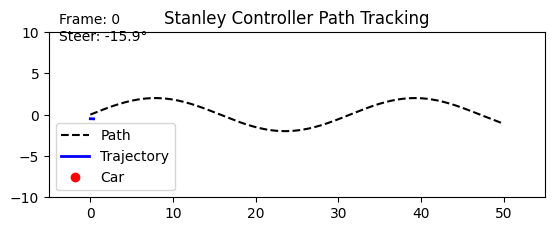

In [ ]:
# Checkpoint 3.1
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# ---------------- Stanley Controller ----------------
def stanley_steering(x, y, yaw, v, waypoints, k=1.0, ks=1e-2, max_steer=np.radians(30)):
    L = 2.5
    fx = x + L * np.cos(yaw)
    fy = y + L * np.sin(yaw)

    dists = np.linalg.norm(waypoints - np.array([fx, fy]), axis=1)
    target_idx = np.argmin(dists)

    if target_idx < len(waypoints) - 1:
        next_target = waypoints[target_idx + 1]
    else:
        next_target = waypoints[target_idx]

    path_dx = next_target[0] - waypoints[target_idx][0]
    path_dy = next_target[1] - waypoints[target_idx][1]
    path_yaw = np.arctan2(path_dy, path_dx)

    heading_error = path_yaw - yaw
    heading_error = np.arctan2(np.sin(heading_error), np.cos(heading_error))

    dx = fx - waypoints[target_idx][0]
    dy = fy - waypoints[target_idx][1]
    perp_vec = np.array([np.cos(path_yaw + np.pi / 2), np.sin(path_yaw + np.pi / 2)])
    cross_track_error = np.dot([dx, dy], perp_vec)

    steer = heading_error + np.arctan2(k * cross_track_error, ks + v)
    steer = np.clip(steer, -max_steer, max_steer)

    return steer, target_idx

# ---------------- Path and Vehicle Initialization ----------------
# Path: sine wave
x_path = np.linspace(0, 50, 200)
y_path = 2 * np.sin(0.2 * x_path)
waypoints = np.vstack((x_path, y_path)).T

# Initial vehicle state
x, y, yaw = 0.0, -0.5, np.radians(0)
v = 2.0  # constant speed
L = 2.5
dt = 0.1

# Trajectory history
history = {"x": [x], "y": [y]}

# ---------------- Animation Setup ----------------
fig, ax = plt.subplots()
ax.set_aspect('equal')
ax.set_xlim(-5, 55)
ax.set_ylim(-10, 10)
ax.plot(x_path, y_path, 'k--', label="Path")
car_plot, = ax.plot([], [], 'b-', lw=2, label="Trajectory")
car_dot, = ax.plot([], [], 'ro', label="Car")
text = ax.text(0.02, 0.95, '', transform=ax.transAxes)

def update(frame):
    global x, y, yaw

    steer, _ = stanley_steering(x, y, yaw, v, waypoints)
    yaw += v / L * np.tan(steer) * dt
    x += v * np.cos(yaw) * dt
    y += v * np.sin(yaw) * dt

    history["x"].append(x)
    history["y"].append(y)

    car_plot.set_data(history["x"], history["y"])

    text.set_text(f"Frame: {frame}\nSteer: {np.degrees(steer):.1f}°")

    return car_plot, car_dot, text

ani = FuncAnimation(fig, update, frames=300, interval=50, blit=True)
plt.legend()
plt.title("Stanley Controller Path Tracking")
plt.show()


In [ ]:
# Chcekpoint 3.2
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation

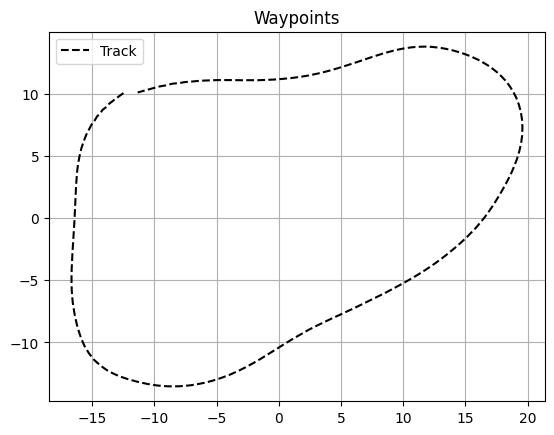

In [ ]:

waypoints = np.load('./waypoints.npy')
# This is the map which was obtained from optimising the waypoints

plt.plot(waypoints[:,0], waypoints[:,1], 'k--', label="Track")
plt.axis("equal")
plt.title("Waypoints")
plt.legend()
plt.grid()
plt.show()

In [ ]:
class Vehicle:
    def __init__(self, x=0, y=-10, yaw=0 , v=0.0, L=2.5):  # Initial position, yaw, velocity, and wheelbase

        self.x = x              #  IMP ! : Change the initial pose of the car to determine the starting position
        self.y = y
        self.yaw = yaw
        self.v = v
        self.L = L  # Wheelbase

    def update(self, throttle, delta, dt=0.1):
        self.x += self.v * np.cos(self.yaw) * dt
        self.y += self.v * np.sin(self.yaw) * dt
        self.yaw += self.v / self.L * np.tan(delta) * dt
        self.v += throttle * dt
        self.v = max(0.0, self.v)  # No reverse


In [ ]:


class PIDController:
    def __init__(self, kp, ki, kd, dt=0.1):
        self.kp = kp
        self.ki = ki
        self.kd = kd
        self.dt = dt

        self.integral = 0
        self.prev_error = 0

    def reset(self):
        self.integral = 0
        self.prev_error = 0

    def compute(self, target, current):
        error = target - current
        self.integral += error * self.dt
        derivative = (error - self.prev_error) / self.dt

        output = self.kp * error + self.ki * self.integral + self.kd * derivative
        self.prev_error = error

        return output



pid_controller = PIDController(kp=1.0, ki=0.1, kd=0.05, dt=0.1)
def compute_control(vehicle, waypoints, last_target_idx, k=5.0, k_soft=1e-2):



    """

    Args:
        vehicle: Vehicle object
        waypoints: Nx2 array
        last_target_idx: previously selected waypoint index
        k: control gain for Stanley
        k_soft: softening term to avoid division by zero

    Returns:
        throttle: float
        steer: float
        target_idx: int

    """

    # Stanley steering
    steer, target_idx = stanley_steering(
        vehicle.x,
        vehicle.y,
        vehicle.yaw,
        vehicle.v,
        waypoints,
        k=k,
        ks=k_soft
    )




    # Limit steering to realistic bounds
    max_steer = np.radians(30)
    steer = np.clip(steer, -max_steer, max_steer) # use imported stanley function here

    # Throttle control (simple proportional control or replace with PID)
    target_v = 10.0  # Target velocity You can change this velocity as per need

    # You must keep in mind that different target velocities will require retuning the steering gains

       # PID-based throttle control
    throttle = pid_controller.compute(target_v, vehicle.v)

    throttle = np.clip(throttle, -1.0, 1.0)

    return throttle, steer, target_idx


In [ ]:
vehicle = Vehicle()
history = {'x': [], 'y': []}
target_idx = 0

fig, ax = plt.subplots(figsize=(6,6))
# ax.set_xlim(-12, 12)
# ax.set_ylim(-12, 12)
track_line, = ax.plot(waypoints[:,0], waypoints[:,1], 'k--')
car_dot, = ax.plot([], [], 'bo', markersize=6)
path_line, = ax.plot([], [], 'b-', linewidth=1)

def init():
    car_dot.set_data([], [])
    path_line.set_data([], [])
    return car_dot, path_line

def animate(i):
    global target_idx
    throttle, steer, target_idx = compute_control(vehicle, waypoints, target_idx)
    vehicle.update(throttle, steer)

    history['x'].append(vehicle.x)
    history['y'].append(vehicle.y)

    car_dot.set_data([vehicle.x], [vehicle.y])

    path_line.set_data(history['x'], history['y'])
    return car_dot, path_line

ani = animation.FuncAnimation(fig, animate, init_func=init,
                              frames=300, interval=50, blit=True)
plt.close()  # Prevent double display in some notebooks

from IPython.display import HTML
HTML(ani.to_jshtml())


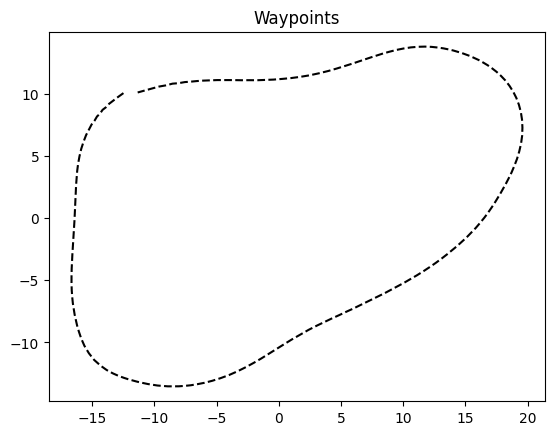

In [ ]:
# Checkpoint 4
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Load waypoints
waypoints = np.load('./waypoints.npy')  # Replace with actual path if needed

plt.plot(waypoints[:, 0], waypoints[:, 1], 'k--', label="Track")
plt.axis("equal")
plt.title("Waypoints")

# Vehicle class
class Vehicle:
    def __init__(self, x=0, y=-10, yaw=0, v=0.0, L=2.5):
        self.x = x
        self.y = y
        self.yaw = yaw
        self.v = v
        self.L = L

    def update(self, throttle, delta, dt=0.1):
        self.x += self.v * np.cos(self.yaw) * dt
        self.y += self.v * np.sin(self.yaw) * dt
        self.yaw += self.v / self.L * np.tan(delta) * dt
        self.v += throttle * dt
        self.v = max(0.0, self.v)  # prevent reverse

# PID controller
class PIDController:
    def __init__(self, kp, ki, kd, dt=0.1):
        self.kp = kp
        self.ki = ki
        self.kd = kd
        self.dt = dt
        self.integral = 0
        self.prev_error = 0

    def compute(self, target, current):
        error = target - current
        self.integral += error * self.dt
        derivative = (error - self.prev_error) / self.dt
        output = self.kp * error + self.ki * self.integral + self.kd * derivative
        self.prev_error = error
        return output

pid_controller = PIDController(kp=400.0, ki=50, kd=40, dt=0.1)

# Stanley steering function
def stanley_steering(x, y, yaw, v, waypoints, k=3, ks=0.1):
    # Find nearest point on path
    dx = waypoints[:, 0] - x
    dy = waypoints[:, 1] - y
    dists = np.hypot(dx, dy)
    target_idx = np.argmin(dists)
    target_x = waypoints[target_idx, 0]
    target_y = waypoints[target_idx, 1]
    path_yaw = np.arctan2(waypoints[min(target_idx+1, len(waypoints)-1), 1] - target_y,
                          waypoints[min(target_idx+1, len(waypoints)-1), 0] - target_x)

    heading_error = path_yaw - yaw
    heading_error = np.arctan2(np.sin(heading_error), np.cos(heading_error))  # Normalize

    # Cross track error
    map_to_car_x = np.cos(yaw) * dx[target_idx] + np.sin(yaw) * dy[target_idx]
    map_to_car_y = -np.sin(yaw) * dx[target_idx] + np.cos(yaw) * dy[target_idx]
    crosstrack_error = map_to_car_y

    steer = heading_error + np.arctan2(k * crosstrack_error, ks + v)
    return steer, target_idx

# Compute control
def compute_control(vehicle, waypoints, last_target_idx, k=3, k_soft=1e-2):

    steer, target_idx = stanley_steering(
        vehicle.x, vehicle.y, vehicle.yaw, vehicle.v, waypoints, k, k_soft
    )
       # Limit steering to realistic bounds
    max_steer = np.radians(30)
    steer = np.clip(steer, -max_steer, max_steer)

    # Throttle control (simple proportional control or replace with PID)
    target_v = 10.0
    throttle = pid_controller.compute(target_v, vehicle.v)
      # You must keep in mind that different target velocities will require retuning the steering gains
    throttle = np.clip(throttle, -1.0, 1.0)

    return throttle, steer, target_idx

# Animate
vehicle = Vehicle()
history = {'x': [], 'y': []}
target_idx = 0

fig, ax = plt.subplots(figsize=(6, 6))
ax.plot(waypoints[:, 0], waypoints[:, 1], 'k--', label="Track")
car_dot, = ax.plot([], [], 'ro', markersize=6)
path_line, = ax.plot([], [], 'b-', linewidth=1)

def init():
    car_dot.set_data([], [])
    path_line.set_data([], [])
    return car_dot, path_line

def animate(i):
    global target_idx
    throttle, steer, target_idx = compute_control(vehicle, waypoints, target_idx)
    vehicle.update(throttle, steer)

    history['x'].append(vehicle.x)
    history['y'].append(vehicle.y)

    car_dot.set_data([vehicle.x], [vehicle.y])  # Wrap in lists
    path_line.set_data(history['x'], history['y'])
    return car_dot, path_line

ani = animation.FuncAnimation(fig, animate, init_func=init,
                              frames=300, interval=50, blit=True)

plt.close()
HTML(ani.to_jshtml())
